# REGRESSION PART

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from plotly import graph_objects as go
from plotly import express as px
from plotly.offline import init_notebook_mode, iplot

In [2]:
games = pd.read_csv("vgsales.csv")

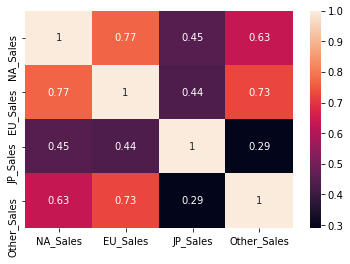

In [23]:
all_sales = games.loc[:, ["NA_Sales", "EU_Sales", "JP_Sales", "Other_Sales"]]
sns.heatmap(all_sales.corr(), annot=True)
plt.show()

Max Correlation -> NA_Sales - EU_Sales <br>
Min Correlation -> JP_Sales - Other Sales 

###  Ordinary Least squares method - Linear Regression

In [3]:
def linear_regression(strX, strY):
    fig = px.scatter(games, x=strX, y=strY, opacity=0.65,
        trendline='ols', trendline_color_override='red'
    )
    fig.show()

In [22]:
linear_regression("NA_Sales", "EU_Sales")

In [28]:
linear_regression("Other_Sales", "JP_Sales")

### Polinomial Regression

In [30]:
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures

def format_coefs(coefs):
    equation_list = [f"{coef}x^{i}" for i, coef in enumerate(coefs)]
    equation = "$" +  " + ".join(equation_list) + "$"

    replace_map = {"x^0": "", "x^1": "x", '+ -': '- '}
    for old, new in replace_map.items():
        equation = equation.replace(old, new)

    return equation

def polynomial_regression(strX, strY):
    X = games.Global_Sales.values.reshape(-1, 1)
    x_range = np.linspace(X.min(), X.max(), 100).reshape(-1, 1)

    fig = px.scatter(games, x=strX, y=strY, opacity=0.65)
    for degree in [1, 2, 3, 4]:
        poly = PolynomialFeatures(degree)
        poly.fit(X)
        X_poly = poly.transform(X)
        x_range_poly = poly.transform(x_range)

        model = LinearRegression(fit_intercept=False)
        model.fit(X_poly, games[strY])
        y_poly = model.predict(x_range_poly)

        equation = format_coefs(model.coef_.round(2))
        fig.add_traces(go.Scatter(x=x_range.squeeze(), y=y_poly, name=equation))

    fig.show()

In [31]:
polynomial_regression("EU_Sales", "NA_Sales")

In [32]:
polynomial_regression("Other_Sales", "JP_Sales")

### Prediction Error Analysis

In [8]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
def prediction_error_analysis(strx1, strx2, stry):
    reg_games = games

    train_idx, test_idx = train_test_split(reg_games.index, test_size=.25, random_state=0)
    reg_games['split'] = 'train'
    reg_games.loc[test_idx, 'split'] = 'test'

    X = reg_games[[strx1, strx2]]
    y = reg_games[stry]
    X_train = reg_games.loc[train_idx, [strx1, strx2]]
    y_train = reg_games.loc[train_idx, stry]

    model = LinearRegression()
    model.fit(X_train, y_train)
    reg_games['prediction'] = model.predict(X)

    fig = px.scatter(reg_games, x=stry, y='prediction',
        marginal_x='histogram', marginal_y='histogram',
        color='split', trendline='ols'
    )
    fig.update_traces(histnorm='probability', selector={'type':'histogram'})
    fig.add_shape(type="line", line=dict(dash='dash'),
        x0=y.min(), y0=y.min(),
        x1=y.max(), y1=y.max()
    )

    fig.show()

In [33]:
prediction_error_analysis("EU_Sales", "EU_Sales", "NA_Sales")

In [34]:
prediction_error_analysis("EU_Sales", "EU_Sales", "EU_Sales")

In [35]:
prediction_error_analysis("EU_Sales", "Global_Sales", "EU_Sales")

In [37]:
prediction_error_analysis("Other_Sales", "EU_Sales", "JP_Sales")

In [38]:
prediction_error_analysis("EU_Sales", "EU_Sales", "Other_Sales")

### Multiple Regression Analysis

In [15]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

def multiple_regression_analysis(strx1, strx2, stry):
    X = games[[strx1, strx2]]
    y = games[stry]

    model = LinearRegression()
    model.fit(X, y)
    print(model.intercept_)
    print(model.coef_)
    medv =  stry + " = "+ str(model.intercept_) + "+ (" + str(model.coef_[0]) + " * " + strx1 + ") + (" + str(model.coef_[1]) + " * " + strx2 + ")"
    print(medv)

In [16]:
multiple_regression_analysis("EU_Sales", "Global_Sales", "NA_Sales")

-0.008848255617316891
[-0.71573855  0.70422692]
NA_Sales = -0.008848255617316891+ (-0.7157385515797785 * EU_Sales) + (0.7042269246016017 * Global_Sales)


### According to the Regional Sales Linear Regression in Type

In [39]:
def linear_regression_intype(strx,stry):
    fig = px.scatter(games, x=strx, y=stry, color = "Genre",
                     opacity=0.65,trendline='ols')
    fig.show()

In [41]:
linear_regression_intype("NA_Sales","EU_Sales")

In [42]:
linear_regression_intype("Other_Sales","JP_Sales")

In [43]:
linear_regression_intype("Other_Sales","EU_Sales")

### Reference : <br>
https://plotly.com/python/ml-regression/